In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import os
from sklearn.model_selection import train_test_split

import numpy as np


import torch
import torch.nn as nn
import torchvision
from torchvision.transforms import v2
from torch.utils.data import Dataset

#Get rid of SettingWithCopyWarnings
pd.options.mode.chained_assignment = None  


In [2]:
PNW = pd.read_csv('../../Data/processedData/PNW/PNW.csv')
PNW = PNW.dropna()
PNW["flowering"] = PNW['reproductiveCondition'].isin(['flowering','flowering|fruiting','flowering|fruiting|flower budding','flowering|flower budding']).astype(int)
PNW["fruiting"] = PNW['reproductiveCondition'].isin(['fruiting','flowering|fruiting','flowering|fruiting|flower budding','fruiting|flower budding']).astype(int)
PNW["flowering|fruiting"] = PNW['reproductiveCondition'].isin(['fruiting', 'flowering', 'flowering|fruiting','flowering|fruiting|flower budding']).astype(int)

photoPath = "D:\PNW_Angiosperms\labeled_photos"

In [3]:
#I only have 49,999 so I'm missing one photo. The following code drops that row from the dataframe
for fname in PNW['file_name']: 
    if not os.path.isfile(photoPath + "/" + fname):
        PNW = PNW[PNW['file_name'] != fname]

In [4]:
photos = PNW[["file_name", "flowering"]].reset_index(drop=True)

In [5]:
# Define relevant variables for the ML task
batch_size = 64
num_classes = 10
learning_rate = 0.001
num_epochs = 20

# Device will determine whether to run the training on GPU or CPU.
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [6]:
#Some of our images are .pngs, we drop the alpha. 
train_transform = v2.Compose([
    #Rely on the v2 transforms from torchvision.transforms.v2

    #Use tensors instead of PIL images

    #Use torch.uint8 dtype, especially for resizing
                                v2.ToPILImage(),
                                v2.ToTensor(),
                                v2.RandomAffine(degrees=(-180,180), translate=(0,.1), scale=(.9,1)),
                                v2.RandomHorizontalFlip(p=0.5),
                                v2.RandomVerticalFlip(p=0.5),
                                v2.ColorJitter(brightness=.3, hue=.01),
                                v2.Resize ( (256,256) , interpolation=2 ),
                                v2.CenterCrop(224),
                                v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

                            ])
val_transform = v2.Compose([
                                v2.ToPILImage(),
                                v2.ToTensor(),
                                v2.Resize ( (256,256) , interpolation=2 ),
                                v2.CenterCrop(224),
                                v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                            ])
target_transform = v2.Compose([
                                v2.Lambda(lambda x: torch.tensor(x).long()),
                            ])                         

c:\Users\Sean Haight\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\transforms\v2\_deprecated.py:41: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.
  warnings.warn(


In [7]:
import os
import pandas as pd
from torchvision.io import read_image

class CustomImageDataset(Dataset):
    def __init__(self, label_frame, img_dir, transform=None, target_transform=None):
        self.img_labels = label_frame
        self.img_dir = img_dir
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_labels.iloc[idx, 0])
        image = read_image(img_path)
        label = self.img_labels.iloc[idx, 1]
        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            label = self.target_transform(label)
        return image, label

In [8]:
from torch.utils.data import DataLoader

all_data = CustomImageDataset(photos, photoPath, train_transform, target_transform)


all_dataloader = DataLoader(all_data, batch_size=64, shuffle=False)


In [9]:
import torchvision.models as models
from torchvision.models.resnet import ResNet, BasicBlock, Bottleneck

class SeanBlock(BasicBlock):
    def __init__(self, inplanes, planes, stride=1, downsample=None, groups=1, base_width=64, dilation=1, norm_layer=None):
        super(SeanBlock, self).__init__(inplanes, planes, stride, downsample, groups, base_width, dilation, norm_layer)
        self.dropout_prob = .5
        
    def forward(self,x):
        identity = x
        
        out = self.conv1(x)
        out = self.bn1(out)
        out = nn.Dropout(self.dropout_prob)(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)
        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)
        return out
    
class SeanBottleneck(Bottleneck):
    def __init__(self, inplanes, planes, stride=1, downsample=None, groups=1, base_width=64, dilation=1, norm_layer=None):
        super(SeanBottleneck, self).__init__(inplanes, planes, stride, downsample, groups, base_width, dilation, norm_layer)
        self.dropout_prob = .375
    
    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = nn.Dropout(self.dropout_prob)(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = nn.Dropout(self.dropout_prob)(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out
class MyResNet50(ResNet):
    def __init__(self):
        super(MyResNet50, self).__init__(SeanBottleneck, [3, 4, 6, 3])
        
    def forward(self, x):
        # change forward here
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)

        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.fc(x)
        return x


model = MyResNet50()
# if you need pretrained weights
model.load_state_dict(torch.load("C:/Users/Sean Haight/Documents/Coding/Personal Projects/Flower Identification Project/Models/PNW/resnet50midtrain.pt"))

criterion = torch.nn.CrossEntropyLoss()  
optimizer = torch.optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

model.to(device)

MyResNet50(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): SeanBottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), str

In [10]:
prediction_list = []
target_list = []

with torch.no_grad():
    for data, target in all_dataloader:
        data = data.to(device)
        target = target.to(device)
        output = model(data)
        _, pred = torch.max(output, 1)
        prediction_list = prediction_list + pred.tolist()
        target_list.append(target)
        print(len(prediction_list))

64
128
192
256
320
384
448
512
576
640
704
768
832
896
960
1024
1088
1152
1216
1280
1344
1408
1472
1536
1600
1664
1728
1792
1856
1920
1984
2048
2112
2176
2240
2304
2368
2432
2496
2560
2624
2688
2752
2816
2880
2944
3008
3072
3136
3200
3264
3328
3392
3456
3520
3584
3648
3712
3776
3840
3904
3968
4032
4096
4160
4224
4288
4352
4416
4480
4544
4608
4672
4736
4800
4864
4928
4992
5056
5120
5184
5248
5312
5376
5440
5504
5568
5632
5696
5760
5824
5888
5952
6016
6080
6144
6208
6272
6336
6400
6464
6528
6592
6656
6720
6784
6848
6912
6976
7040
7104
7168
7232
7296
7360
7424
7488
7552
7616
7680
7744
7808
7872
7936
8000
8064
8128
8192
8256
8320
8384
8448
8512
8576
8640
8704
8768
8832
8896
8960
9024
9088
9152
9216
9280
9344
9408
9472
9536
9600
9664
9728
9792
9856
9920
9984
10048
10112
10176
10240
10304
10368
10432
10496
10560
10624
10688
10752
10816
10880
10944
11008
11072
11136
11200
11264
11328
11392
11456
11520
11584
11648
11712
11776
11840
11904
11968
12032
12096
12160
12224
12288
12352
12416
12480
12

In [11]:
photos["preds"] = prediction_list

In [12]:
wrong = photos[photos["flowering"] != photos["preds"]]

In [14]:
import matplotlib.pyplot as plt
from PIL import Image

image_paths = [photoPath + "\\" +  name for name in wrong["file_name"]]  

In [22]:
idx = 0

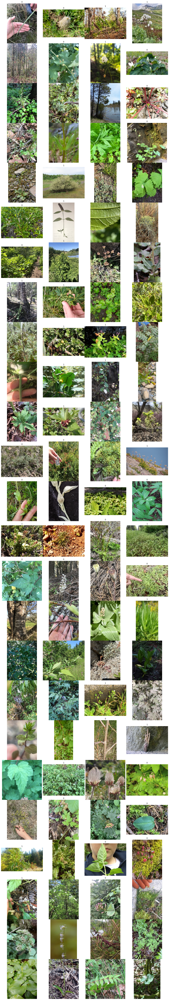

In [35]:
# Replace with your image paths

# Create a figure with 9x9 subplots
fig, axes = plt.subplots(25, 4, figsize=(20, 120))

# Flatten the axes array for easy iteration
axes = axes.flatten()
im_count = 100
for ax, i in zip(axes, list(range(min(im_count, len(wrong) - idx)))):
    img_path = photoPath + "\\" + wrong["file_name"].iloc[i + idx]
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(wrong["flowering"].iloc[i])  # Hide the axes

# Adjust spacing between subplots
plt.subplots_adjust(wspace=0, hspace=0)

# Show the plot
plt.show()

### After looking at some of the labeled images, it looks like a non-trivial number are "mis-labeled". This could be due to the fact that the image comes from an observation that is flowering but this particular image does not contain a flower. I've decided to go through and relabel some subset of these. 

In [34]:
label_flip_list = [1,2,8,12,14,16,17,22,25,28,30,35,38,45,46,48,51,52,53,59,63,65,73,75]

for k in label_flip_list: 
    photos["flowering"].iloc[idx + k] = 1 - photos["flowering"].iloc[idx + k]

idx = idx + im_count

In [29]:
len(wrong)

7286

In [36]:
photos.to_csv('../../Data/processedData/PNW/labeled_PNW_obs_600.csv', index=False)